# Use the markers across the wall to see if the disparity is same as the edges

In [1]:
import numpy as np
import depthai as dai
import cv2
import cv2.aruco as aruco
from matplotlib import pyplot as plt
from scipy.spatial.transform import Rotation as R

In [2]:
aruco_dictionary = aruco.Dictionary_get(aruco.DICT_5X5_250)
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10000, 0.00001)

def show_rgb_image(image, title=None, conversion=cv2.COLOR_BGR2RGB):

    # Converts from one colour space to the other. this is needed as RGB
    # is not the default colour space for OpenCV
    image = cv2.cvtColor(image, conversion)

    plt.figure(figsize=(12, 8))
    # remove the axis / ticks for a clean looking image
    plt.xticks([])
    plt.yticks([])

    # if a title is provided, show it
    if title is not None:
        plt.title(title)
    plt.imshow(image)


def display_overlay_points(left_pts, right_pts, markerSize = 20, setSize = True):
    plt.figure(figsize=(12, 8))
    plt.rcParams["figure.autolayout"] = True
    if setSize:
        plt.xlim(0, size[0])
        plt.ylim(0, size[1])
    plt.grid()

    x = left_pts[0, :, 0]
    y = left_pts[0, :, 1]
    color = "blue"
    plt.scatter(x, y, c=color, s = markerSize)

    x = right_pts[0, :, 0]
    y = right_pts[0, :, 1]
    color = "red"
    plt.scatter(x, y, c=color, s = markerSize)


    # ?plt.plot(x, y, marker="o", markersize=4, markeredgecolor="red", markerfacecolor="green")
    plt.show()

def detectMarkers(image_rgb):
    image = cv2.cvtColor(image_rgb, cv2.COLOR_BGR2GRAY)
    marker_corners, ids, rejectedImgPoints = cv2.aruco.detectMarkers(image, aruco_dictionary)
    # print(f'Shape of markers corners => {(rejectedImgPoints)}')
    index = np.where(ids == 5)
    img_with_markers = cv2.aruco.drawDetectedMarkers(image_rgb.copy(), marker_corners, ids)

    # Remove the item at the specified index
    # print(f'Share of original ids shape {ids.shape}')
    # ids = np.delete(ids, index[0][0])
    # ids = ids.reshape(-1, 1)
    # print(f'Share of modified ids shape {ids.shape}')

    if 0:
        for i in range(len(marker_corners)):
            print(f'Id is -> {ids[i]}')
            print(marker_corners[i])
            
    marker_corners_list = []
    for i, marker in enumerate(marker_corners):
        # if i == index:
        #     continue
        marker_corners_list.append(marker[-1])
    marker_corners_list = np.asarray(marker_corners_list).reshape(-1, 2)

    cv2.cornerSubPix(image, marker_corners_list, (3,3), (-1,-1), criteria)
    if 0:
        print('From marker corners list --------->')
        for i in range(len(marker_corners_list)):
            print(f'Id is -> {ids[i // 4]} with corner {marker_corners_list[i]}')
    print(f'Final shape of markers is {len(marker_corners_list)} with ids shape {ids.shape}')
    return marker_corners_list, ids, img_with_markers

def display_overlay_points(left_pts, right_pts, markerSize = 20):
    plt.figure(figsize=(12, 8))
    plt.rcParams["figure.autolayout"] = True
    plt.xlim(0, size[0])
    plt.ylim(0, size[1])
    plt.grid()

    x = left_pts[0, :, 0]
    y = left_pts[0, :, 1]
    color = "blue"
    plt.scatter(x, y, c=color, s = markerSize)

    x = right_pts[0, :, 0]
    y = right_pts[0, :, 1]
    color = "red"
    plt.scatter(x, y, c=color, s = markerSize)


    # ?plt.plot(x, y, marker="o", markersize=4, markeredgecolor="red", markerfacecolor="green")
    plt.show()

size = (1920, 1200)
z_distance_cm = 350
MG_focal = None
def dispDepthConverter(disparity): # Does Disparity to Depth or Depth to disparity. 
    return 10 * MG_focal[0][0] / disparity

def z_error(disp):
    return ((z_distance_cm - dispDepthConverter(disp)) / z_distance_cm) * 100

In [3]:
def parse_dataset(folder_name, calib_path, ts):
    global MG_focal
    calibration_handler = dai.CalibrationHandler(calib_path)
    M_left = np.array(calibration_handler.getCameraIntrinsics(calibration_handler.getStereoLeftCameraId(), size[0], size[1]))
    M_right = np.array(calibration_handler.getCameraIntrinsics(calibration_handler.getStereoRightCameraId(), size[0], size[1]))
    D_left = np.array(calibration_handler.getDistortionCoefficients(calibration_handler.getStereoLeftCameraId()))
    D_right = np.array(calibration_handler.getDistortionCoefficients(calibration_handler.getStereoRightCameraId()))
    transform = np.array(calibration_handler.getCameraExtrinsics(calibration_handler.getStereoRightCameraId(), calibration_handler.getStereoLeftCameraId())) 
    
    left_rot_right = transform[:3, :3]
    left_t_right = transform[:3, 3]
    # Left is basically the origin here so
    origin_rot_right = left_rot_right
    origin_t_right = left_t_right
    origin_rot_left = np.eye(3, dtype = np.float32)
    
    R1 = np.array(calibration_handler.getStereoLeftRectificationRotation())
    R2 = np.array(calibration_handler.getStereoRightRectificationRotation())
    M_focal = cv2.fisheye.estimateNewCameraMatrixForUndistortRectify(M_right, D_right, size, np.eye(3), fov_scale=1.1)
    MG_focal = M_focal
    mapXL, mapYL = cv2.fisheye.initUndistortRectifyMap(M_left, D_left[:4], R1, M_focal, size, cv2.CV_32FC1)
    mapXR, mapYR = cv2.fisheye.initUndistortRectifyMap(M_right, D_right[:4], R2, M_focal, size, cv2.CV_32FC1)

    def file_name(type, ts):
        return f'capture_{type}_AR0234_1920x1200_exp_0_iso_0_lens_0_{ts}'
    left_image = cv2.imread(folder_name + '/' + file_name('left', ts) + '.png')
    right_image = cv2.imread(folder_name + '/' + file_name('right', ts) + '.png')
    # show_rgb_image(left_image, 'Left Image')
    # show_rgb_image(right_image, 'right image')
    print(left_image.shape)
    
    ## Marker detection
    left_markers, left_ids, left_img_with_markers = detectMarkers(left_image)
    right_markers, right_ids, right_img_with_markers = detectMarkers(right_image)
    show_rgb_image(left_img_with_markers, 'Left  detected  Image')
    show_rgb_image(right_img_with_markers, 'right detected Image')

    display_overlay_points(left_markers[None], right_markers[None])

    left_rectify_points = cv2.fisheye.undistortPoints(left_markers[None], M_left, D_left, R = R1, P = M_focal)
    right_rectify_points = cv2.fisheye.undistortPoints(right_markers[None], M_right, D_right, R = R2, P = M_focal)
    # display_overlay_points(left_rectify_points, right_rectify_points, 3)

    left_rect = cv2.remap(left_image , mapXL, mapYL, cv2.INTER_CUBIC, borderMode=cv2.BORDER_CONSTANT)
    right_rect = cv2.remap(right_image, mapXR, mapYR, cv2.INTER_CUBIC, borderMode=cv2.BORDER_CONSTANT)
    # show_rgb_image(left_rect, 'Left rect Image')
    # show_rgb_image(right_rect, 'right rect image')
    
    left_indirect_rectify_points, left_ids_indirect, left_img_with_markers = detectMarkers(left_rect)
    right_indirect_rectify_points, right_ids_indirect, right_img_with_markers = detectMarkers(right_rect)
    show_rgb_image(left_img_with_markers, 'Left rect detected  Image')
    show_rgb_image(right_img_with_markers, 'right rect detected Image')
    # display_overlay_points(left_indirect_rectify_points[None], right_indirect_rectify_points[None], 3)

    
    # for i in range(len(left_ids_indirect)):
    #     print(f'Left and right ids are {left_ids_indirect[i]} and {right_ids_indirect[i]}')
    #     print(f'Left and right ids direct are {left_ids[i]} and {right_ids[i]}')
    list_disparity_indirect = []
    
    for i in range(len(left_ids_indirect)):
        index = np.where(right_ids_indirect == left_ids_indirect[i][0])
        left_idx = i * 4
        right_idx = index[0][0] * 4
        
        list_disparity_indirect.append(left_indirect_rectify_points[left_idx, 0] - right_indirect_rectify_points[right_idx, 0])
        list_disparity_indirect.append(left_indirect_rectify_points[left_idx + 1, 0] - right_indirect_rectify_points[right_idx + 1, 0])
        list_disparity_indirect.append(left_indirect_rectify_points[left_idx + 2, 0] - right_indirect_rectify_points[right_idx + 2, 0])
        list_disparity_indirect.append(left_indirect_rectify_points[left_idx + 3, 0] - right_indirect_rectify_points[right_idx + 3, 0])
        if 0:
            print(f'Left left_ids_indirect at position {left_indirect_rectify_points[left_idx]} & {right_indirect_rectify_points[right_idx]}'
                    f'\n with left marker {left_ids_indirect[i]} and right marker of {right_ids_indirect[index[0][0]]}'
                     f'\n with disparity of {list_disparity_indirect[left_idx]}')
            
            print(f'Left left_ids_indirect at position {left_indirect_rectify_points[left_idx + 1]} & {right_indirect_rectify_points[right_idx + 1]} '
                    f'\n with left marker {left_ids_indirect[i]} and right marker of {right_ids_indirect[index[0][0]]}'
                     f'\n with disparity of {list_disparity_indirect[left_idx + 1]}')
            
            print(f'Left left_ids_indirect at position {left_indirect_rectify_points[left_idx + 2]} & {right_indirect_rectify_points[right_idx + 2]} '
                    f'\n with left marker {left_ids_indirect[i]} and right marker of {right_ids_indirect[index[0][0]]}'
                     f'\n with disparity of {list_disparity_indirect[left_idx + 2]}')
            
            print(f'Left left_ids_indirect at position {left_indirect_rectify_points[left_idx + 3]} & {right_indirect_rectify_points[right_idx + 3]}'
                    f'\n with left marker {left_ids_indirect[i]} and right marker of {right_ids_indirect[index[0][0]]}'
                     f'\n with disparity of {list_disparity_indirect[left_idx + 3]}')
            print (f'---------------------------------------------------')
            print('\n')

    list_disparity_direct = []

    for i in range(len(left_ids)):
        index = np.where(right_ids == left_ids[i])
        left_idx = i * 4
        right_idx = index[0][0] * 4
        list_disparity_direct.append(left_rectify_points[0, left_idx, 0] - right_rectify_points[0, right_idx, 0])
        list_disparity_direct.append(left_rectify_points[0, left_idx + 1, 0] - right_rectify_points[0, right_idx + 1, 0])
        list_disparity_direct.append(left_rectify_points[0, left_idx + 2, 0] - right_rectify_points[0, right_idx + 2, 0])
        list_disparity_direct.append(left_rectify_points[0, left_idx + 3, 0] - right_rectify_points[0, right_idx + 3, 0])
        if 0:
            print(f'Left left_ids at position {left_rectify_points[0, left_idx]} & {right_rectify_points[0, right_idx]}'
                    f'\n with left marker {left_ids[i]} and right marker of {right_ids[index[0][0]]}'
                     f'\n with disparity of {list_disparity_direct[i]}')
            
            print(f'Left left_ids at position {left_rectify_points[0, left_idx + 1]} & {right_rectify_points[0, right_idx + 1]}'
                    f'\n with left marker {left_ids[i]} and right marker of {right_ids[index[0][0]]}'
                     f'\n with disparity of {list_disparity_direct[left_idx + 1]}')
            
            print(f'Left left_ids at position {left_rectify_points[0, left_idx + 2]} & {right_rectify_points[0, right_idx + 2]}'
                    f'\n with left marker {left_ids[i]} and right marker of {right_ids[index[0][0]]}'
                     f'\n with disparity of {list_disparity_direct[left_idx + 2]}')
            
            print(f'Left left_ids at position {left_rectify_points[0, left_idx] + 3} & {right_rectify_points[0, right_idx + 3]}'
                    f'\n with left marker {left_ids[i]} and right marker of {right_ids[index[0][0]]}'
                     f'\n with disparity of {list_disparity_direct[left_idx + 3]}')
            print (f'---------------------------------------------------')
            print('\n')

            
    print('Showing both direct and undirect points form Left and right in the plot below')
    plt.figure(figsize=(12, 8))
    plt.rcParams["figure.autolayout"] = True
    plt.xlim(0, size[0])
    plt.ylim(0, size[1])
    plt.grid()
    
    x = left_indirect_rectify_points[:, 0]
    y = left_indirect_rectify_points[:, 1]
    color = "lightblue"
    plt.scatter(x, y, c=color, s = 1)
    
    x = right_indirect_rectify_points[:, 0]
    y = right_indirect_rectify_points[:, 1]
    color = "orange"
    plt.scatter(x, y, c=color, s = 1)
    
    x = left_rectify_points[0, :, 0]
    y = left_rectify_points[0, :, 1]
    color = "blue"
    plt.scatter(x, y, c=color, s = 1)
    
    x = right_rectify_points[0, :, 0]
    y = right_rectify_points[0, :, 1]
    color = "red"
    plt.scatter(x, y, c=color, s = 1)
    
    plt.show()
            
    list_disparity_direct = np.array(list_disparity_direct)
    list_disparity_indirect = np.array(list_disparity_indirect)
    plt.hist(list_disparity_direct, bins=10, edgecolor='black')
    plt.show()

    plt.hist(list_disparity_indirect, bins=10, edgecolor='black', color='red')
    plt.show()
    print(f' depth at max disparity from the points projection is {dispDepthConverter(np.max(list_disparity_direct))}')
    print(f' depth at min disparity from the points projection is {dispDepthConverter(np.min(list_disparity_direct))}')
    print(f' depth at median disparity from the points projection is {dispDepthConverter(np.median(list_disparity_direct))}')
    print(f'Accuracy at max disparity value of {list_disparity_direct.max()} is  Value -> {((z_distance_cm - dispDepthConverter(list_disparity_direct.max())) / z_distance_cm) * 100}%')
    print(f'Accuracy at Min disparity value of {list_disparity_direct.min()} is  Value -> {((z_distance_cm - dispDepthConverter(list_disparity_direct.min())) / z_distance_cm) * 100}%')
    print(f'Accuracy at median disparity value of {np.median(list_disparity_direct)} is  Value -> {((z_distance_cm - dispDepthConverter(np.median(list_disparity_direct))) / z_distance_cm) * 100}%')
    print('\n')
    print('\n')
    print('\n')
    print(f' depth at max disparity from the undistorted image detection is {dispDepthConverter(np.max(list_disparity_indirect))}')
    print(f' depth at min disparity from the undistorted image detection is {dispDepthConverter(np.min(list_disparity_indirect))}')
    print(f' depth at median disparity from the undistorted image detection is {dispDepthConverter(np.median(list_disparity_indirect))}')
    print(f'Accuracy at max disparity value of {list_disparity_indirect.max()} is  Value -> {((z_distance_cm - dispDepthConverter(list_disparity_indirect.max())) / z_distance_cm) * 100}%')
    print(f'Accuracy at Min disparity value of {list_disparity_indirect.min()} is  Value -> {((z_distance_cm - dispDepthConverter(list_disparity_indirect.min())) / z_distance_cm) * 100}%')
    print(f'Accuracy at median disparity value of {np.median(list_disparity_indirect)} is  Value -> {((z_distance_cm - dispDepthConverter(np.median(list_disparity_indirect))) / z_distance_cm) * 100}%')

    print('\n')
    sorted_indices = np.argsort(left_ids[:, 0])
    for i in sorted_indices:
        marker_index = i * 4
        print('Next marker ------------------------------------')
        print(f'at id {left_ids[i]} z-error direct is {z_error(list_disparity_direct[marker_index])} and undirect is {z_error(list_disparity_indirect[marker_index])}')
        print(f'at id {left_ids[i]} z-error direct is {z_error(list_disparity_direct[marker_index + 1])} and undirect is {z_error(list_disparity_indirect[marker_index + 1])}')
        print(f'at id {left_ids[i]} z-error direct is {z_error(list_disparity_direct[marker_index + 2])} and undirect is {z_error(list_disparity_indirect[marker_index + 2])}')
        print(f'at id {left_ids[i]} z-error direct is {z_error(list_disparity_direct[marker_index + 3])} and undirect is {z_error(list_disparity_indirect[marker_index + 3])}')


## Device 7 Results

(1200, 1920, 3)
Final shape of markers is 28 with ids shape (7, 1)
Final shape of markers is 28 with ids shape (7, 1)


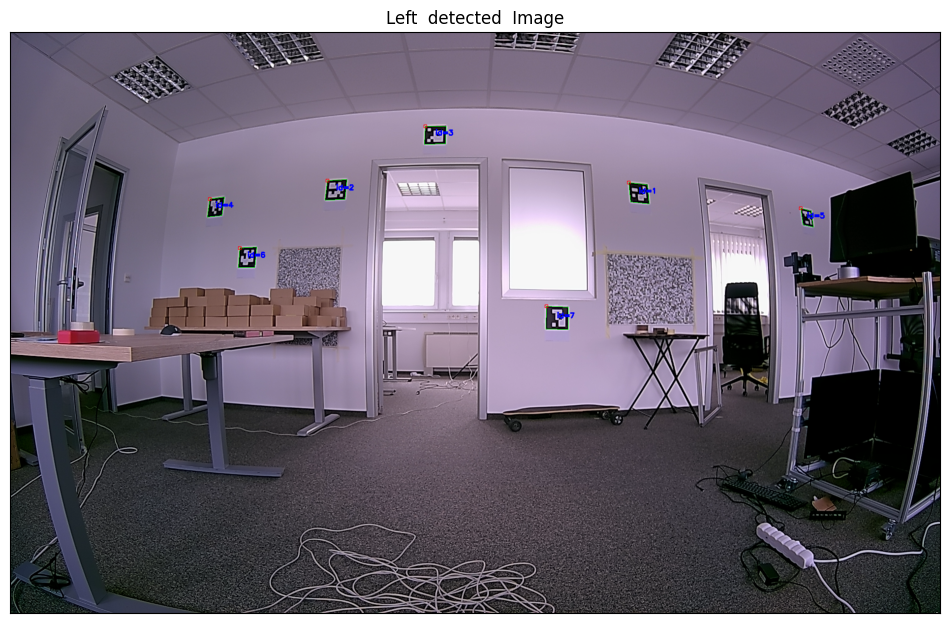

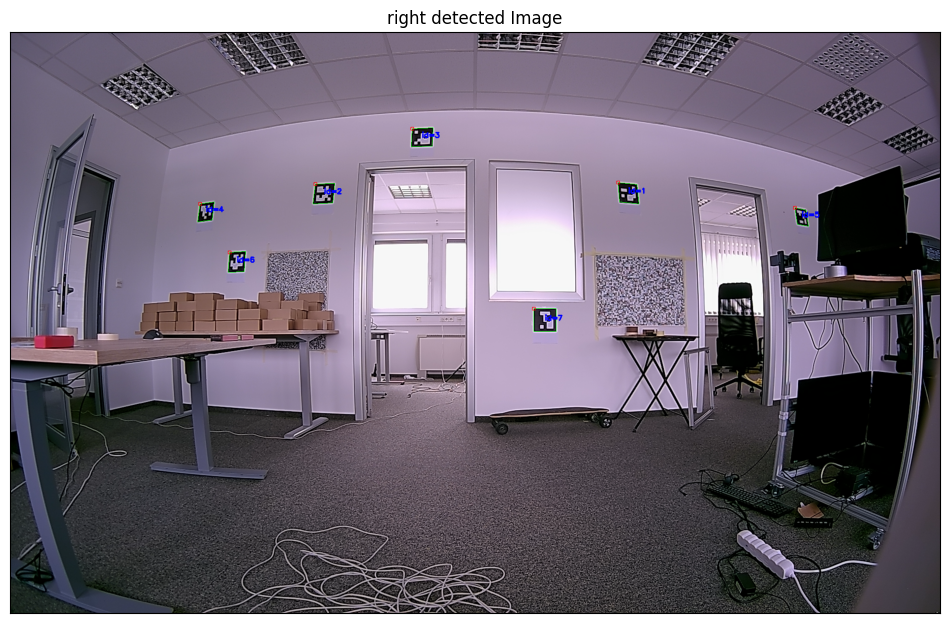

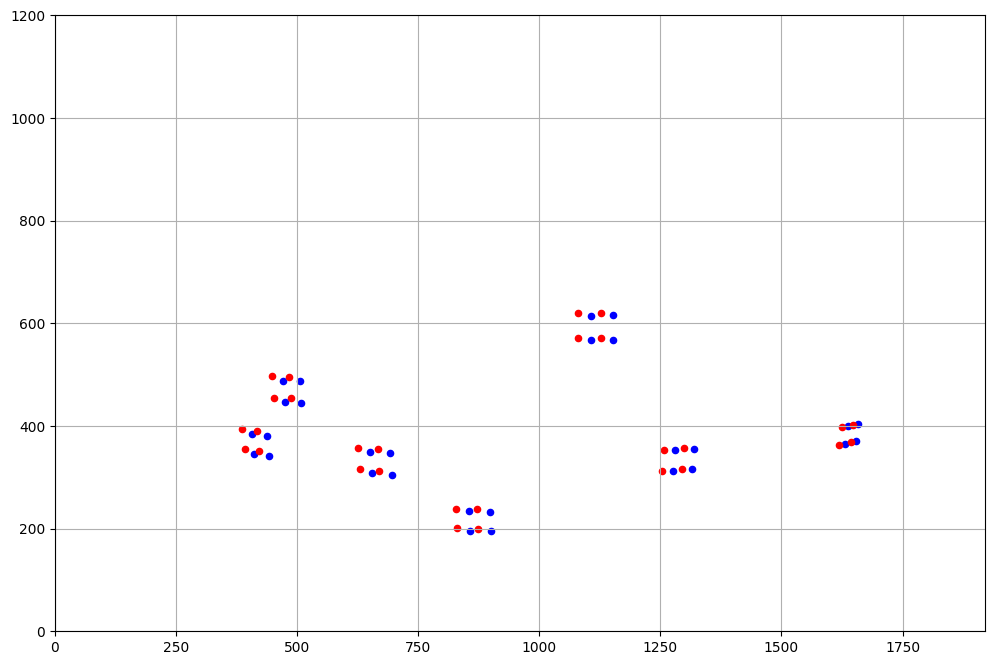

Final shape of markers is 28 with ids shape (7, 1)
Final shape of markers is 28 with ids shape (7, 1)
Showing both direct and undirect points form Left and right in the plot below


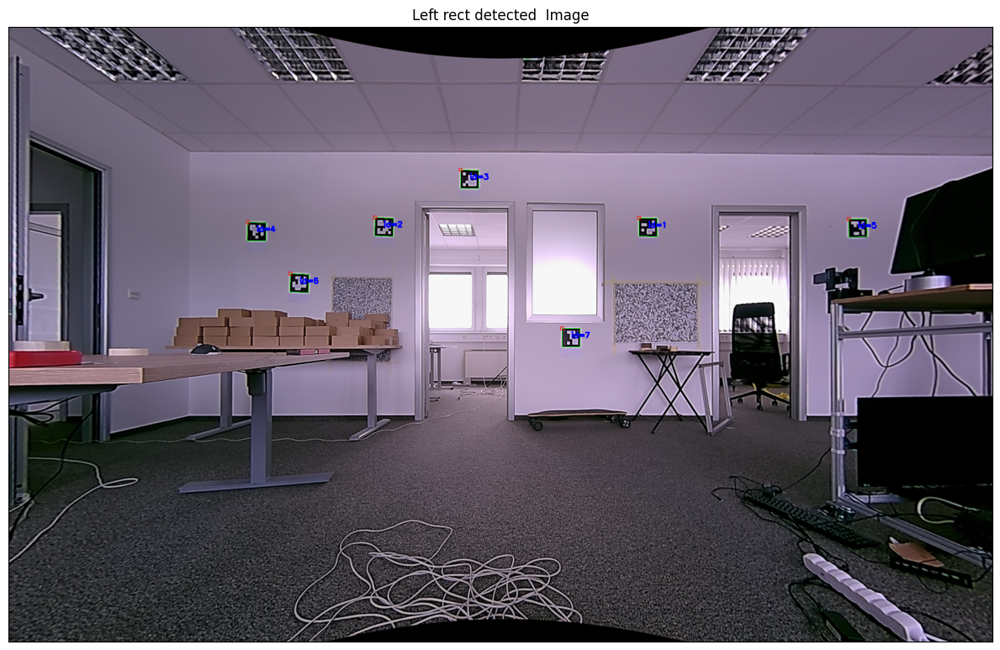

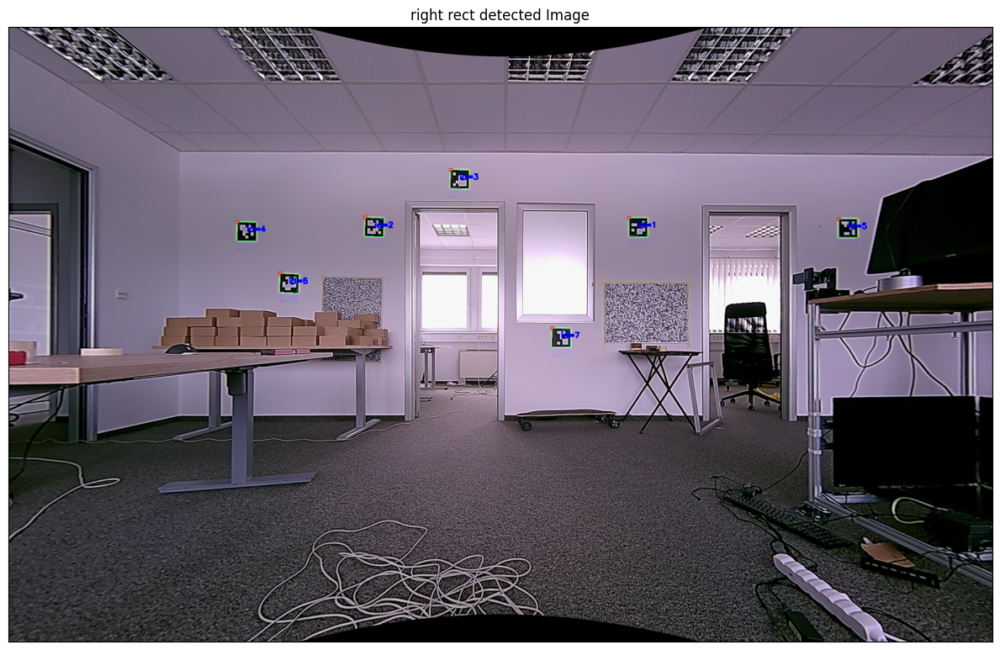

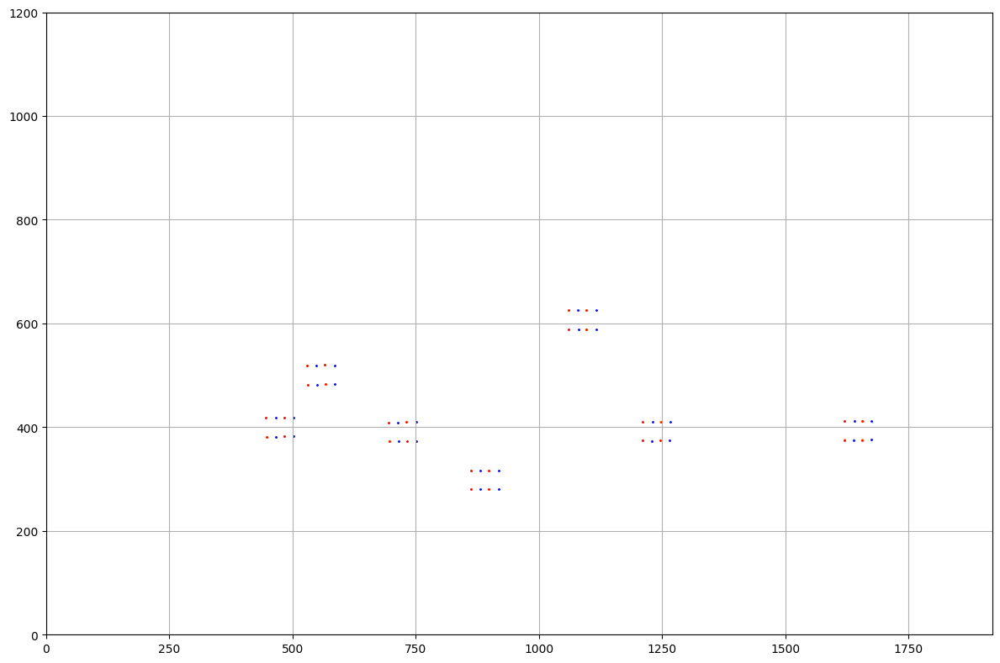

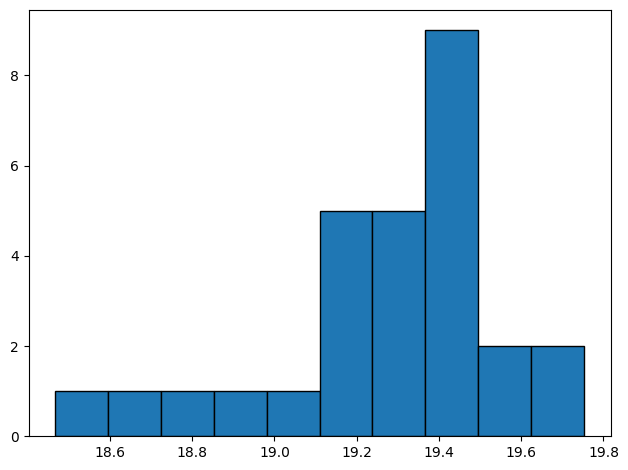

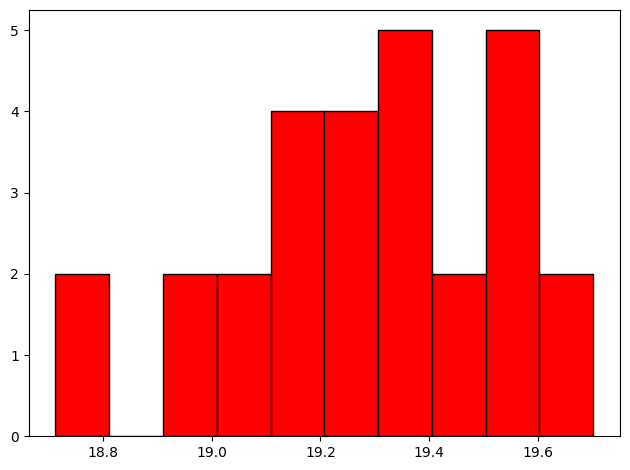

 depth at max disparity from the points projection is 341.74343131372694
 depth at min disparity from the points projection is 365.5493785441986
 depth at median disparity from the points projection is 349.2633365419957
Accuracy at max disparity value of 19.7528076171875 is  Value -> 2.359019624649444%
Accuracy at Min disparity value of 18.4664306640625 is  Value -> -4.44267958405674%
Accuracy at median disparity value of 19.3275146484375 is  Value -> 0.2104752737155065%






 depth at max disparity from the undistorted image detection is 342.61895544979893
 depth at min disparity from the undistorted image detection is 360.75370112488076
 depth at median disparity from the undistorted image detection is 349.6553243401551
Accuracy at max disparity value of 19.70233154296875 is  Value -> 2.1088698714860197%
Accuracy at Min disparity value of 18.7119140625 is  Value -> -3.072486035680218%
Accuracy at median disparity value of 19.30584716796875 is  Value -> 0.09847875995568041%


Next ma

In [4]:
folder_pth = "/Users/blackbird-m1/luxonis/depthai-repos/depthai-python/utilities/cam_7_arucos"
ts = "20230613_120858"
calib_path = "./calib_sensor_07_051923.json"
parse_dataset(folder_pth, calib_path, ts)

## Cam 17 new calib analysis

(1200, 1920, 3)
Final shape of markers is 28 with ids shape (7, 1)
Final shape of markers is 28 with ids shape (7, 1)


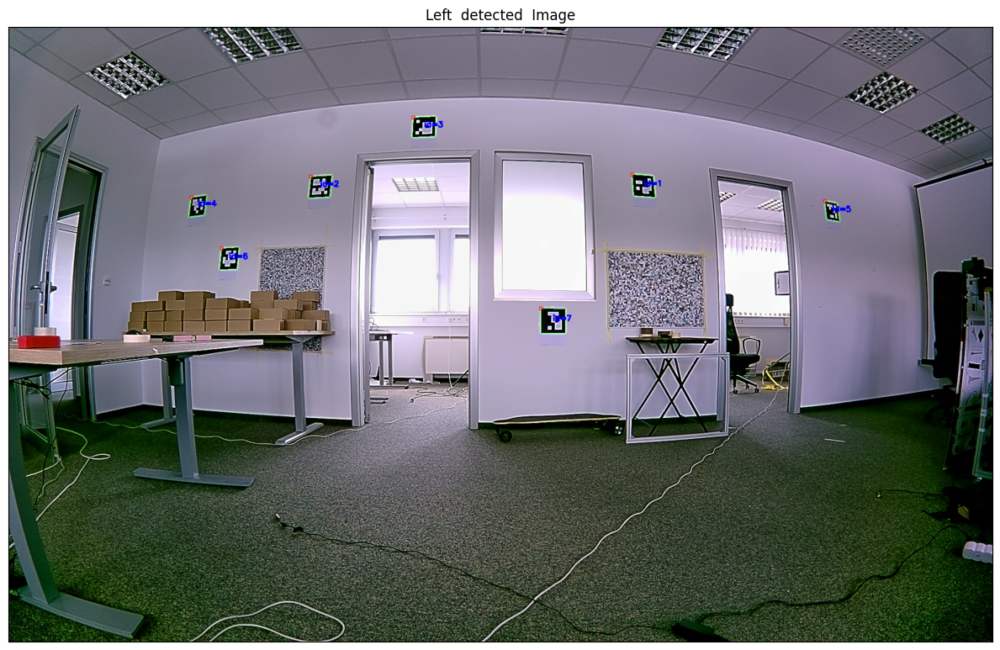

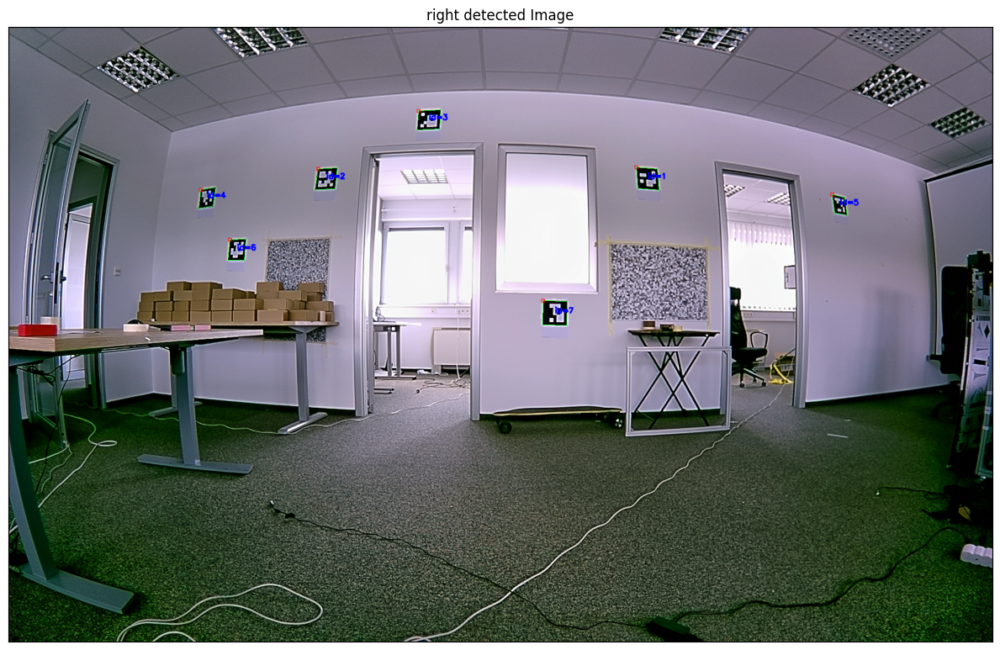

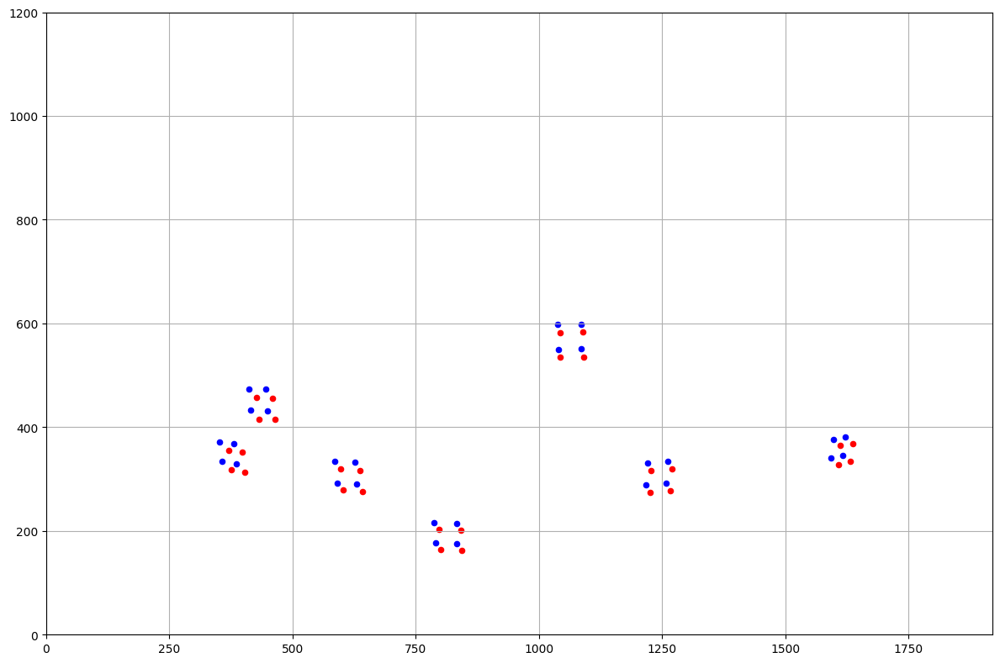

Final shape of markers is 28 with ids shape (7, 1)
Final shape of markers is 28 with ids shape (7, 1)
Showing both direct and undirect points form Left and right in the plot below


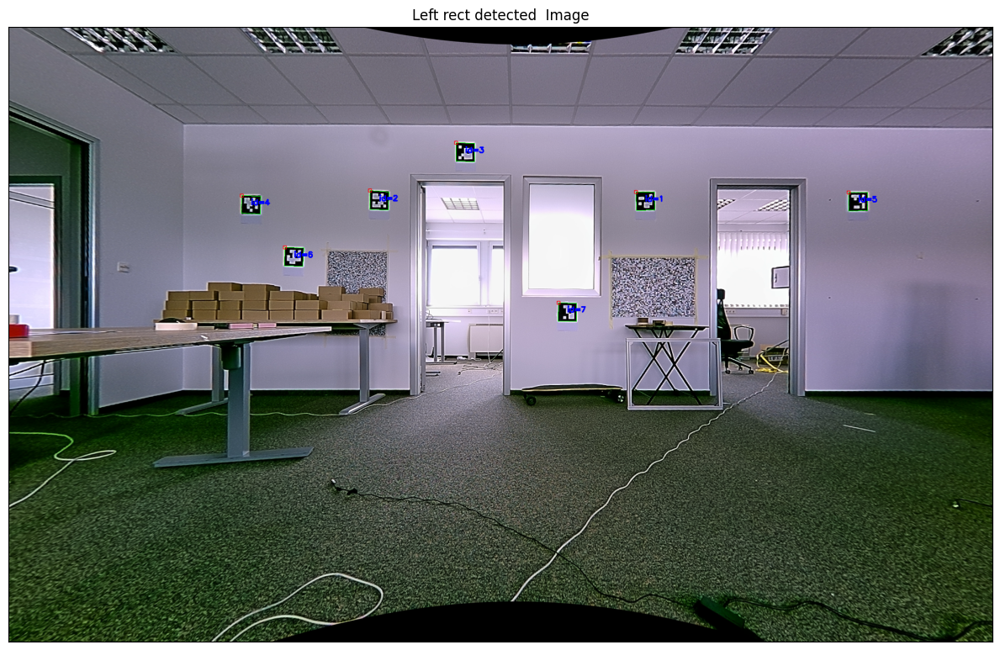

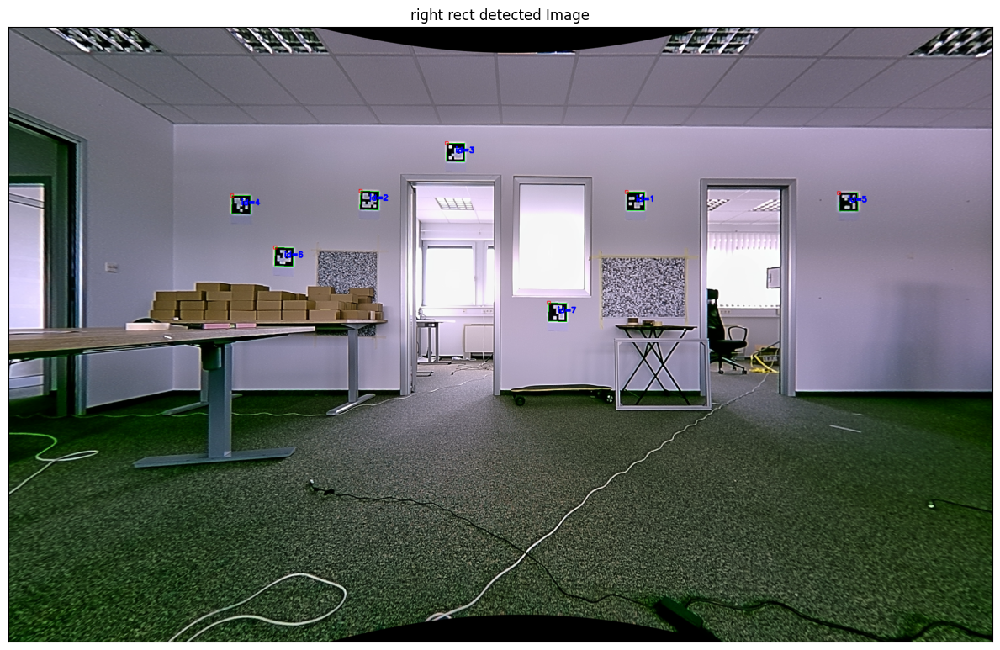

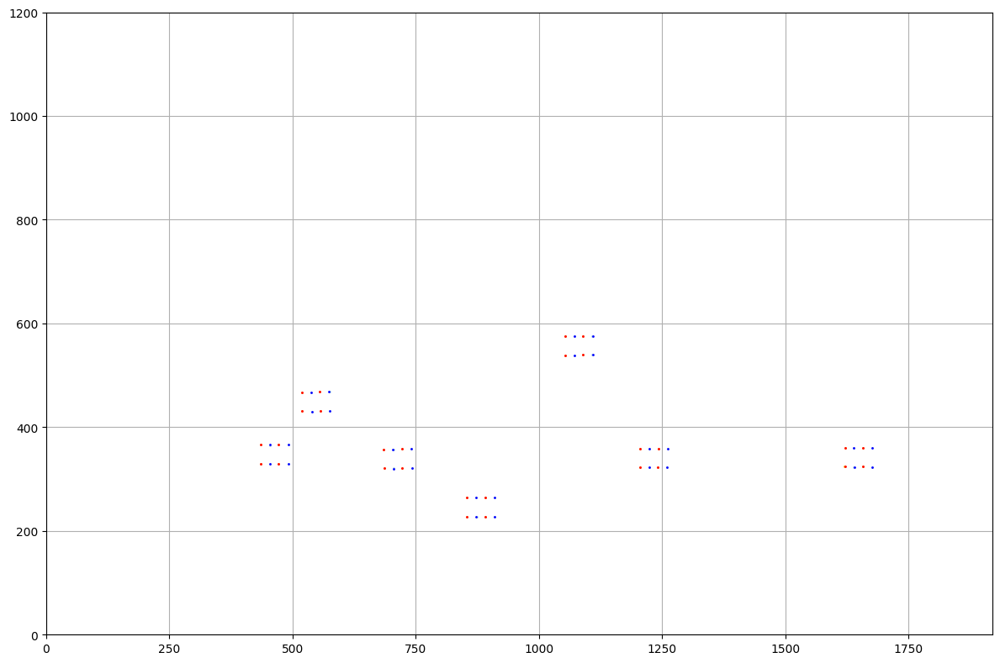

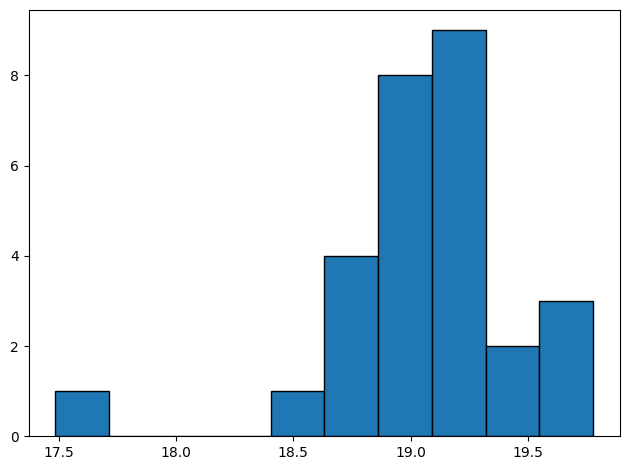

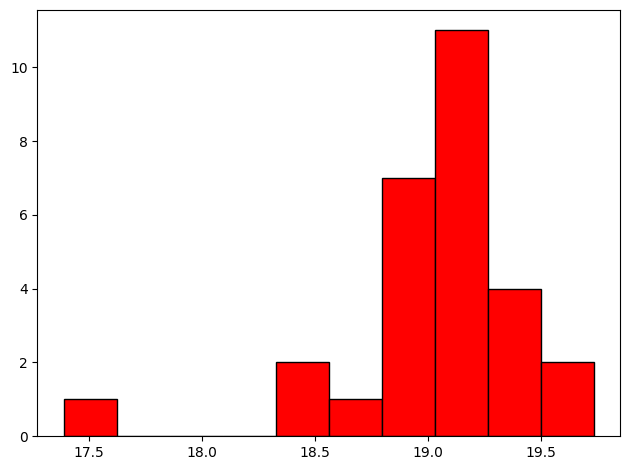

 depth at max disparity from the points projection is 343.36637996249686
 depth at min disparity from the points projection is 388.3722588878356
 depth at median disparity from the points projection is 355.97888601098833
Accuracy at max disparity value of 19.7784423828125 is  Value -> 1.8953200107151815%
Accuracy at Min disparity value of 17.4864501953125 is  Value -> -10.963502539381595%
Accuracy at median disparity value of 19.077682495117188 is  Value -> -1.7082531459966668%






 depth at max disparity from the undistorted image detection is 344.1469632613616
 depth at min disparity from the undistorted image detection is 390.55611671222874
 depth at median disparity from the undistorted image detection is 355.71798869189416
Accuracy at max disparity value of 19.73358154296875 is  Value -> 1.6722962110395492%
Accuracy at Min disparity value of 17.388671875 is  Value -> -11.587461917779642%
Accuracy at median disparity value of 19.0916748046875 is  Value -> -1.633711054826904%


Ne

In [5]:
folder_pth = "/Users/blackbird-m1/luxonis/depthai-repos/depthai-python/utilities/cam_17_arucos"
ts = "20230613_165123"
calib_path = "./calib_17.json"
parse_dataset(folder_pth, calib_path, ts)

## Cam 17 Analysis old calib

(1200, 1920, 3)
Final shape of markers is 28 with ids shape (7, 1)
Final shape of markers is 28 with ids shape (7, 1)


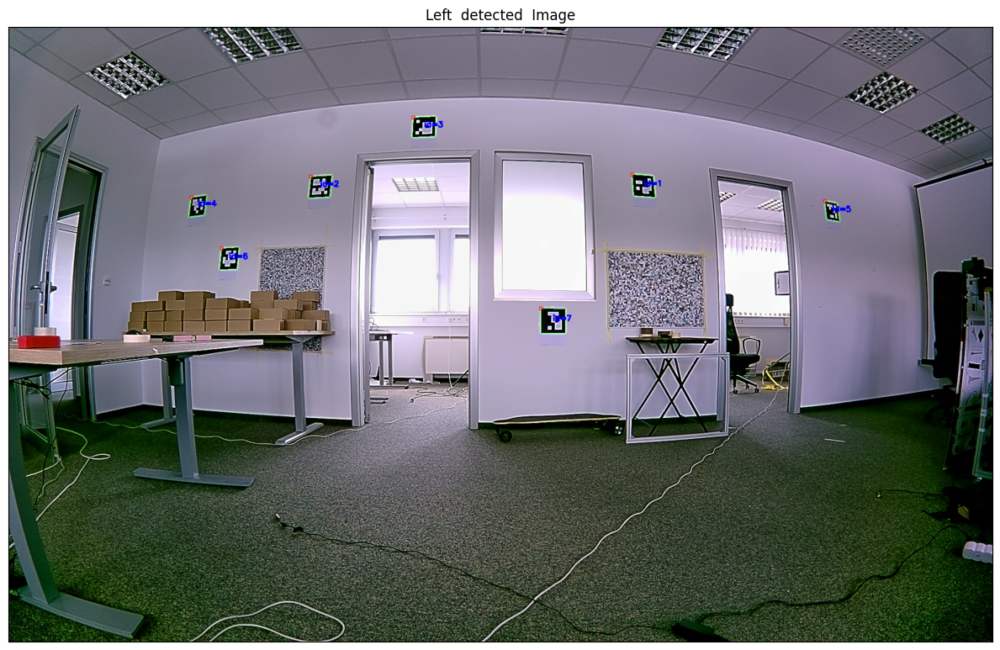

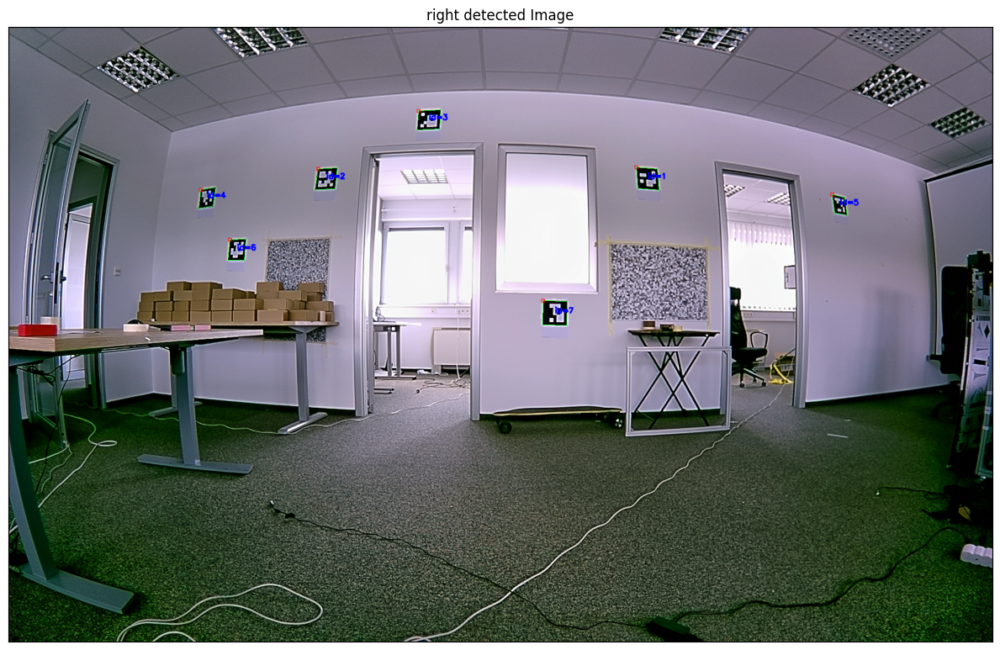

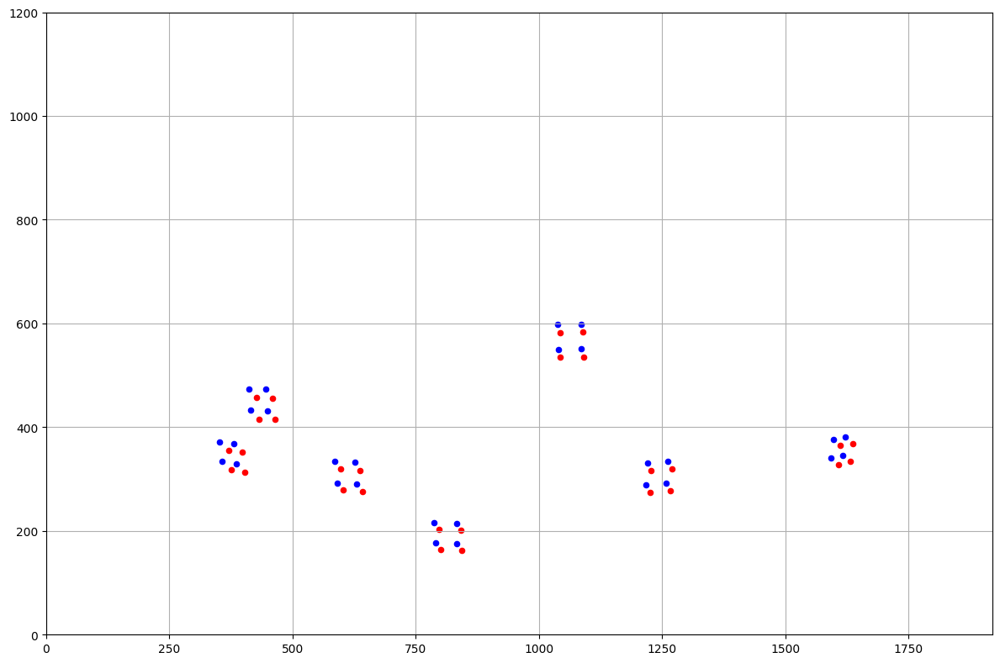

Final shape of markers is 28 with ids shape (7, 1)
Final shape of markers is 28 with ids shape (7, 1)
Showing both direct and undirect points form Left and right in the plot below


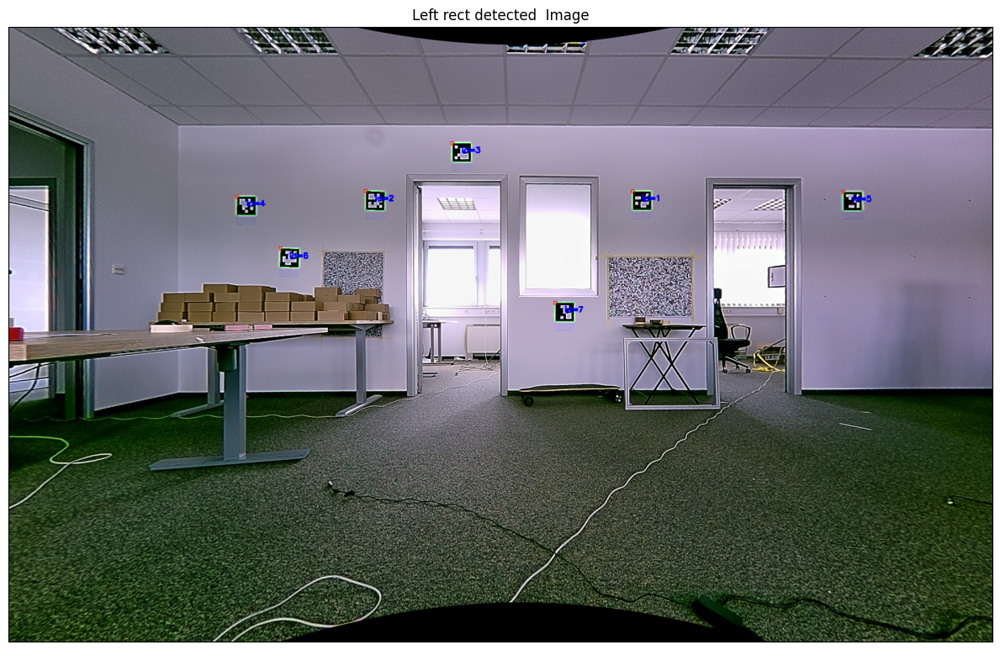

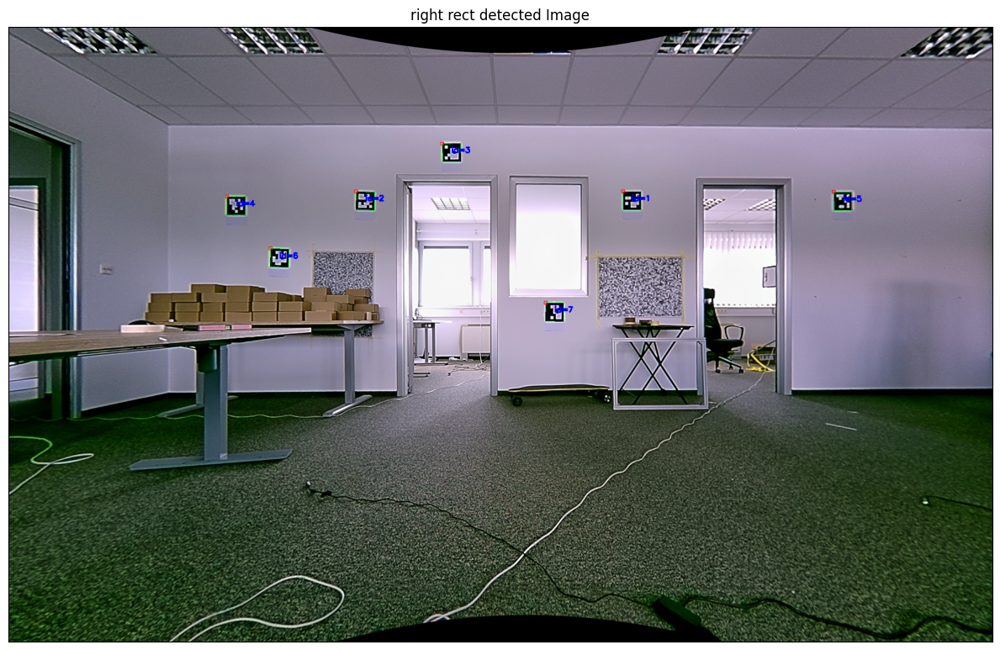

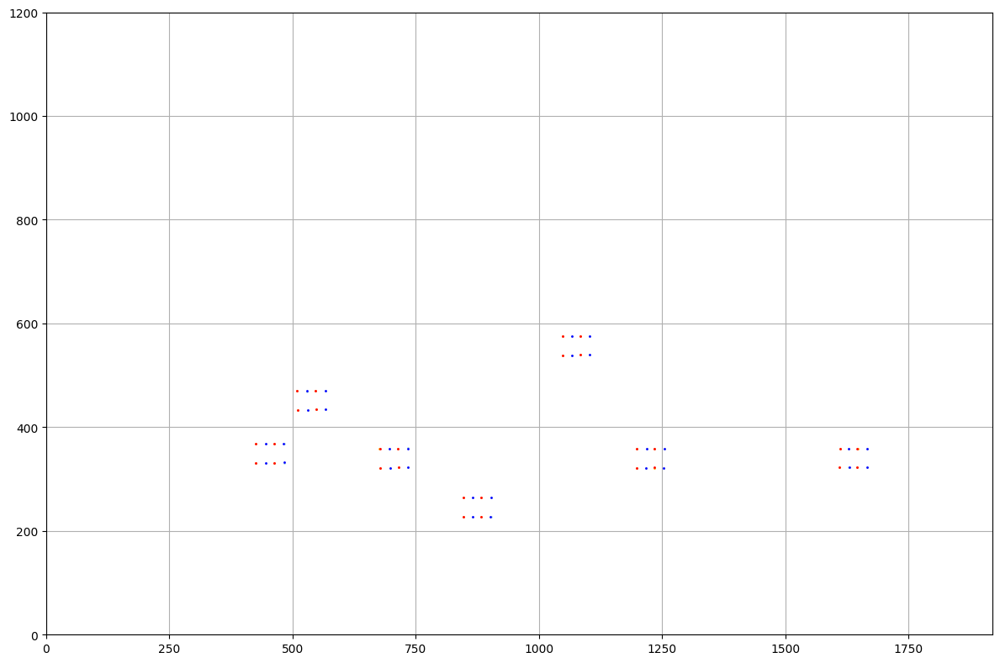

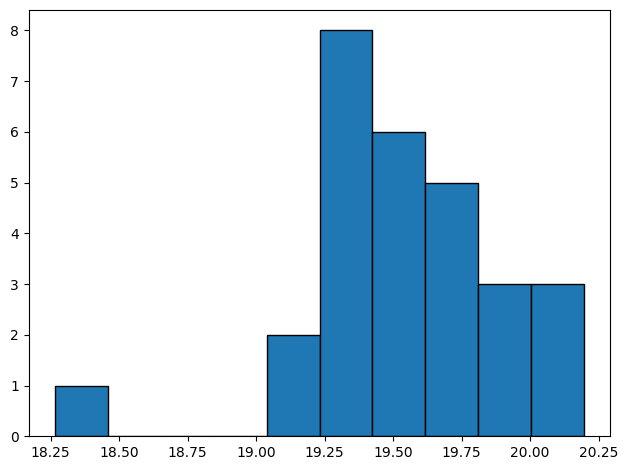

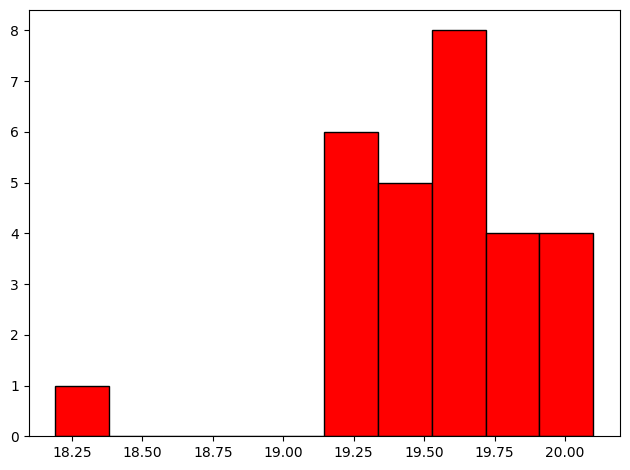

 depth at max disparity from the points projection is 339.00484948072585
 depth at min disparity from the points projection is 374.83542692879917
 depth at median disparity from the points projection is 350.42572647380825
Accuracy at max disparity value of 20.196990966796875 is  Value -> 3.1414715769354706%
Accuracy at Min disparity value of 18.266357421875 is  Value -> -7.09583626537119%
Accuracy at median disparity value of 19.538742065429688 is  Value -> -0.12163613537378687%






 depth at max disparity from the undistorted image detection is 340.63800131040324
 depth at min disparity from the undistorted image detection is 376.38737905913695
 depth at median disparity from the undistorted image detection is 349.8418784855572
Accuracy at max disparity value of 20.10015869140625 is  Value -> 2.674856768456217%
Accuracy at Min disparity value of 18.1910400390625 is  Value -> -7.539251159753412%
Accuracy at median disparity value of 19.57135009765625 is  Value -> 0.04517757555509304%

In [6]:
folder_pth = "/Users/blackbird-m1/luxonis/depthai-repos/depthai-python/utilities/cam_17_arucos"
ts = "20230613_165123"
calib_path = "./calib_17_old.json"
parse_dataset(folder_pth, calib_path, ts)

## CAM 15 Analysis new calib

(1200, 1920, 3)
Final shape of markers is 28 with ids shape (7, 1)
Final shape of markers is 28 with ids shape (7, 1)


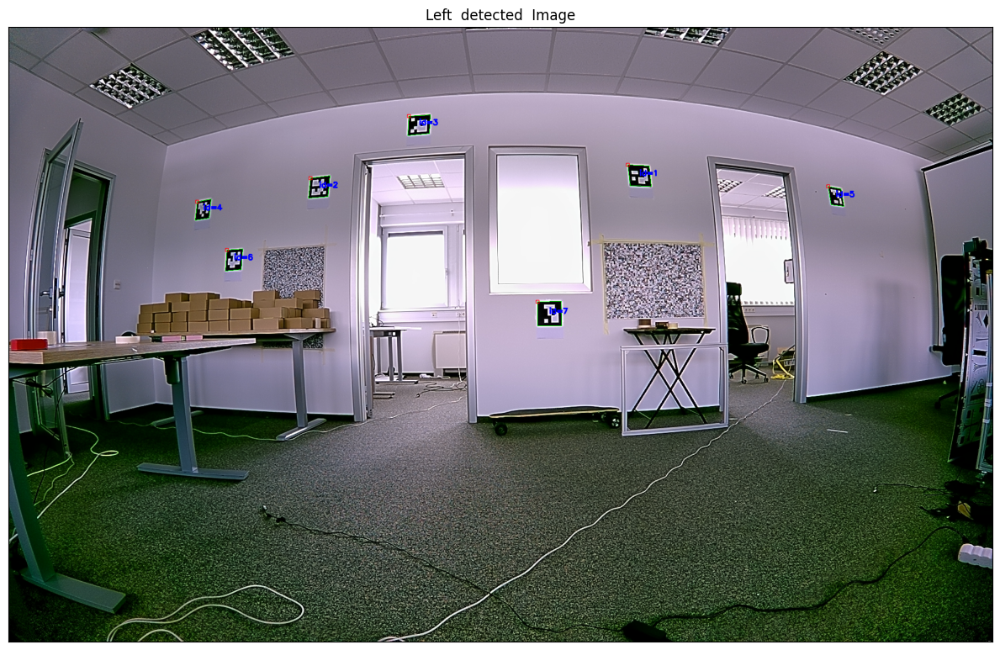

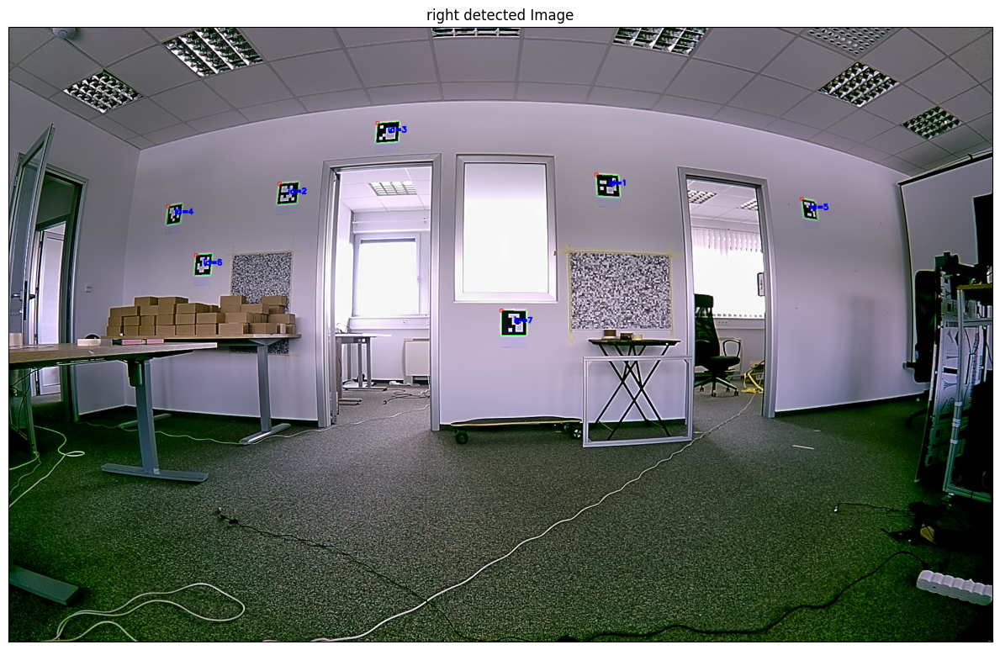

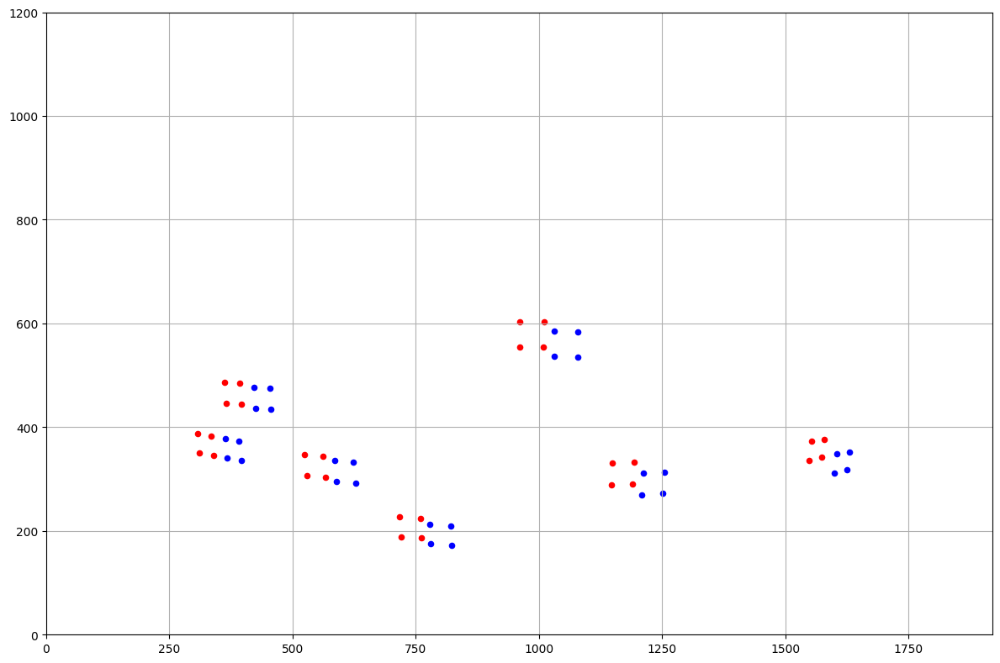

Final shape of markers is 28 with ids shape (7, 1)
Final shape of markers is 28 with ids shape (7, 1)
Showing both direct and undirect points form Left and right in the plot below


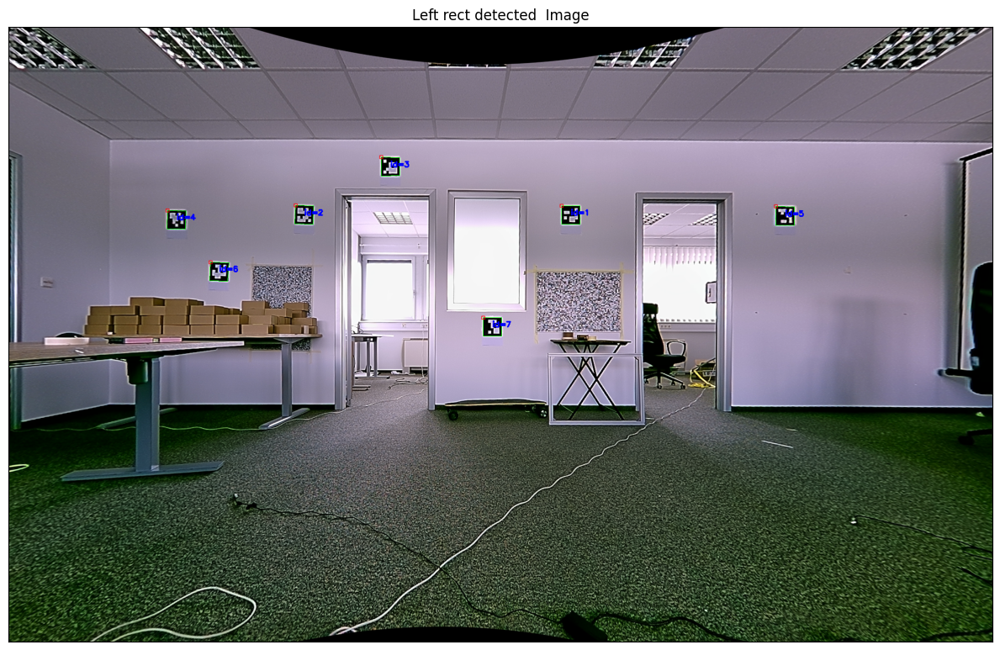

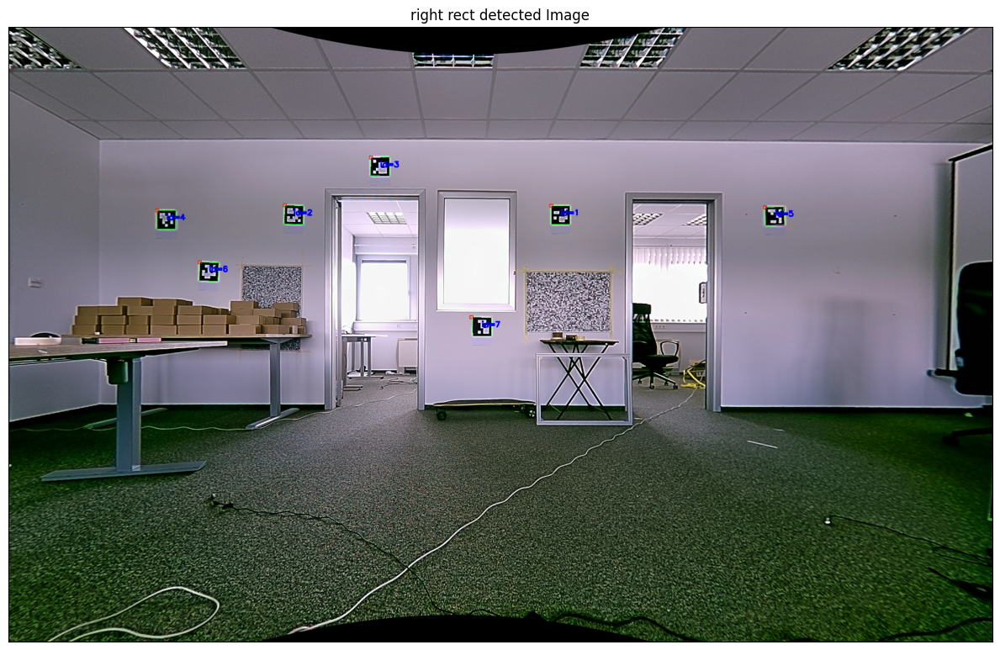

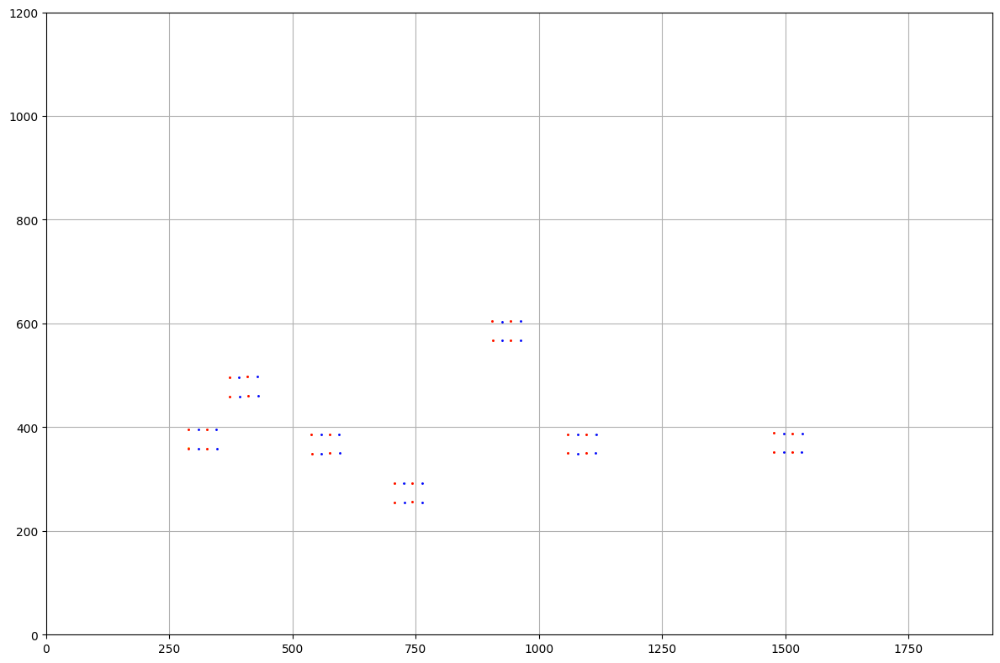

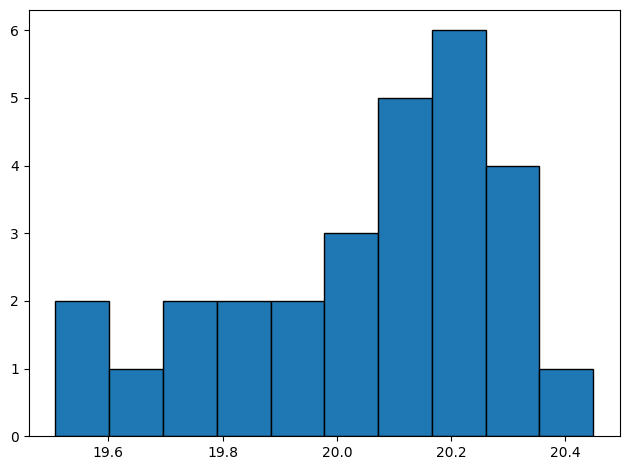

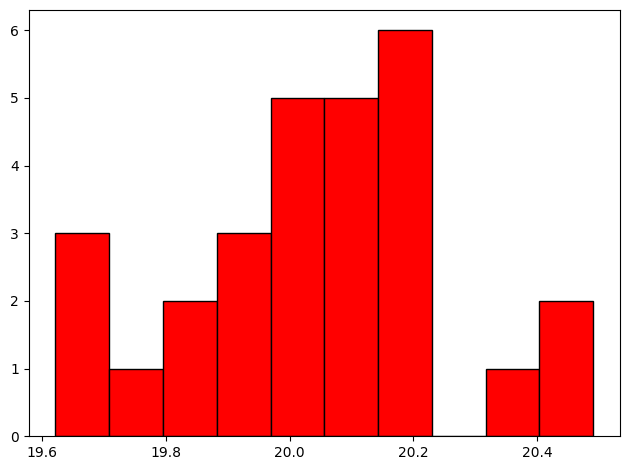

 depth at max disparity from the points projection is 333.9212789167845
 depth at min disparity from the points projection is 350.0343823260827
 depth at median disparity from the points projection is 339.79227795269344
Accuracy at max disparity value of 20.44873046875 is  Value -> 4.593920309490143%
Accuracy at Min disparity value of 19.507415771484375 is  Value -> -0.009823521737920211%
Accuracy at median disparity value of 20.095413208007812 is  Value -> 2.91649201351616%






 depth at max disparity from the undistorted image detection is 333.2419281773175
 depth at min disparity from the undistorted image detection is 348.00207143938627
 depth at median disparity from the undistorted image detection is 340.80384175652716
Accuracy at max disparity value of 20.49041748046875 is  Value -> 4.788020520766427%
Accuracy at Min disparity value of 19.621337890625 is  Value -> 0.5708367316039228%
Accuracy at median disparity value of 20.0357666015625 is  Value -> 2.627473783849382%


Next 

In [7]:
folder_pth = "/Users/blackbird-m1/luxonis/depthai-repos/depthai-python/utilities/cam_15_arucos"
ts = "20230613_170205"
calib_path = "./calib_15_june.json"
parse_dataset(folder_pth, calib_path, ts)

## Cam 15 analysis old calib

(1200, 1920, 3)
Final shape of markers is 28 with ids shape (7, 1)
Final shape of markers is 28 with ids shape (7, 1)


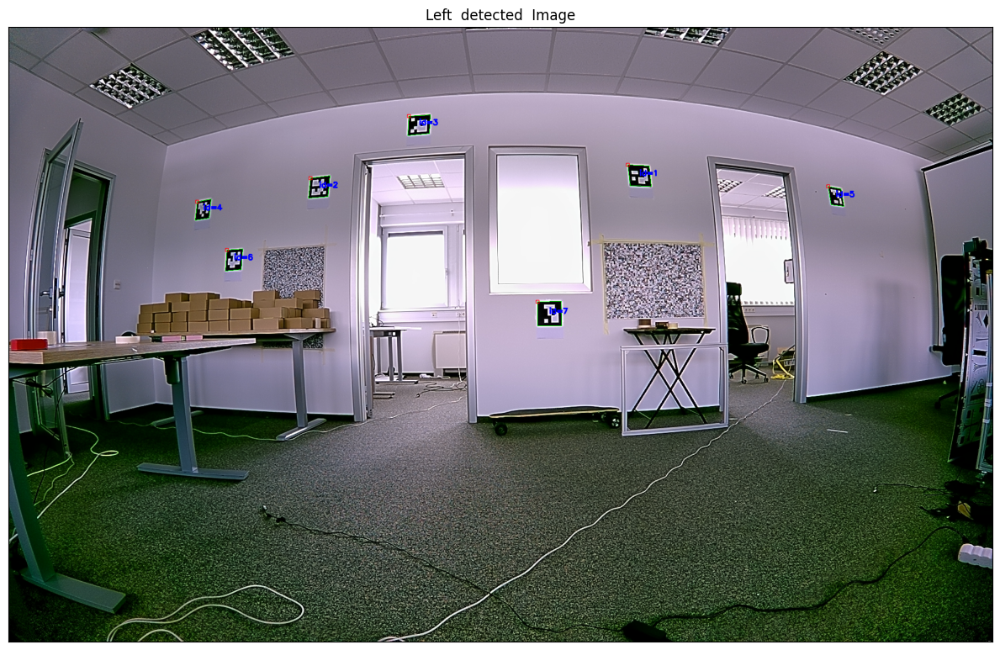

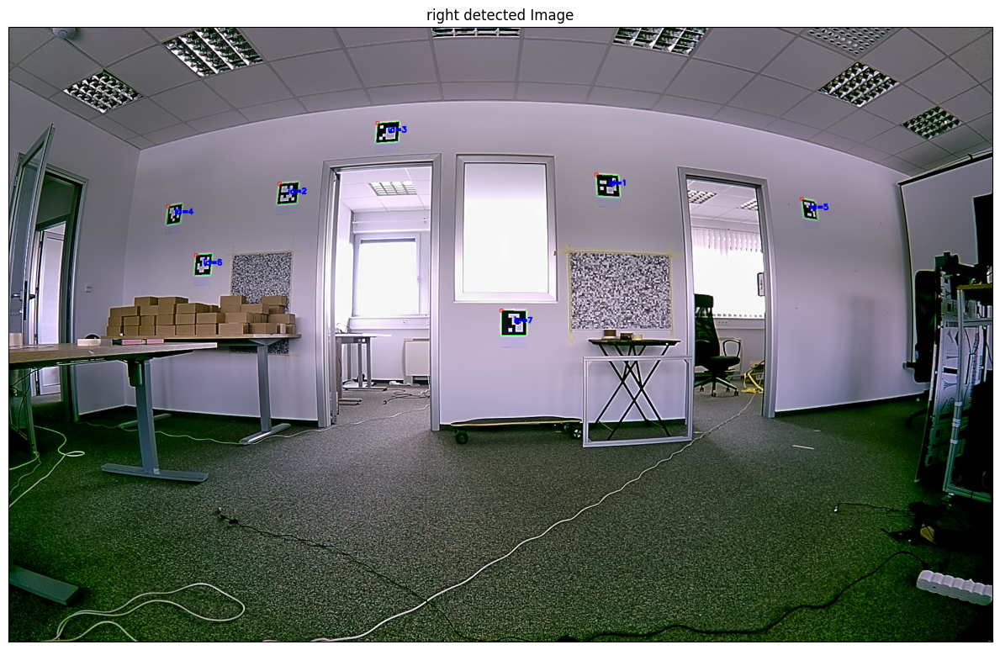

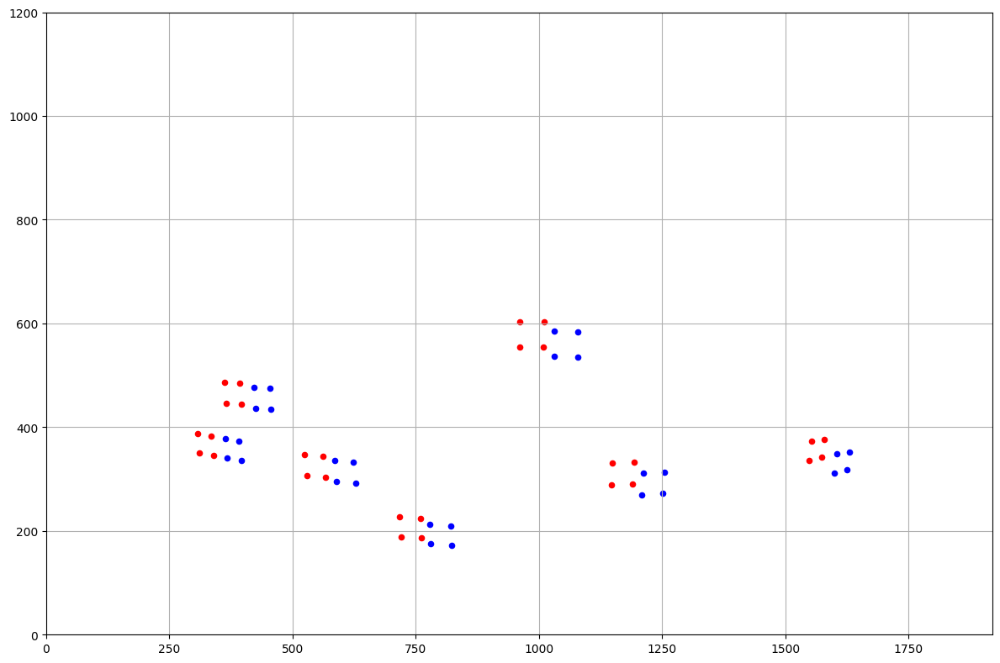

Final shape of markers is 28 with ids shape (7, 1)
Final shape of markers is 28 with ids shape (7, 1)
Showing both direct and undirect points form Left and right in the plot below


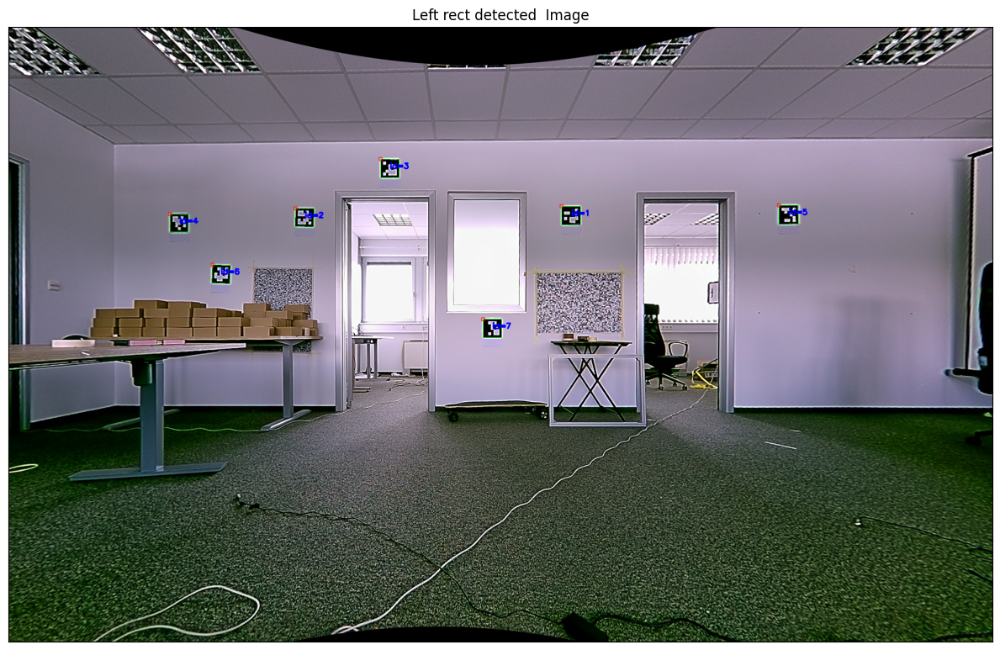

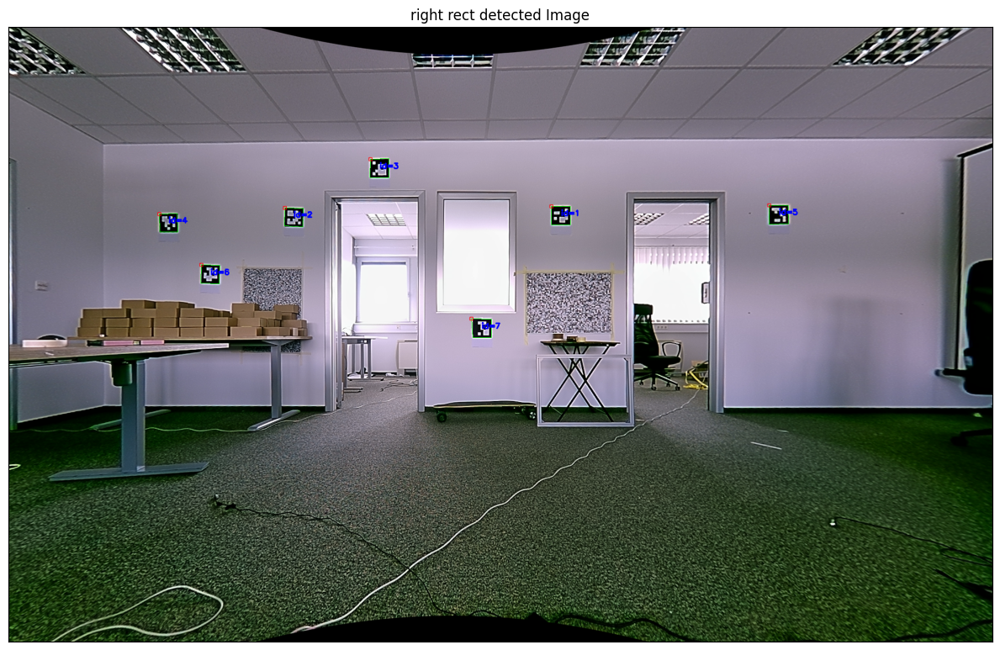

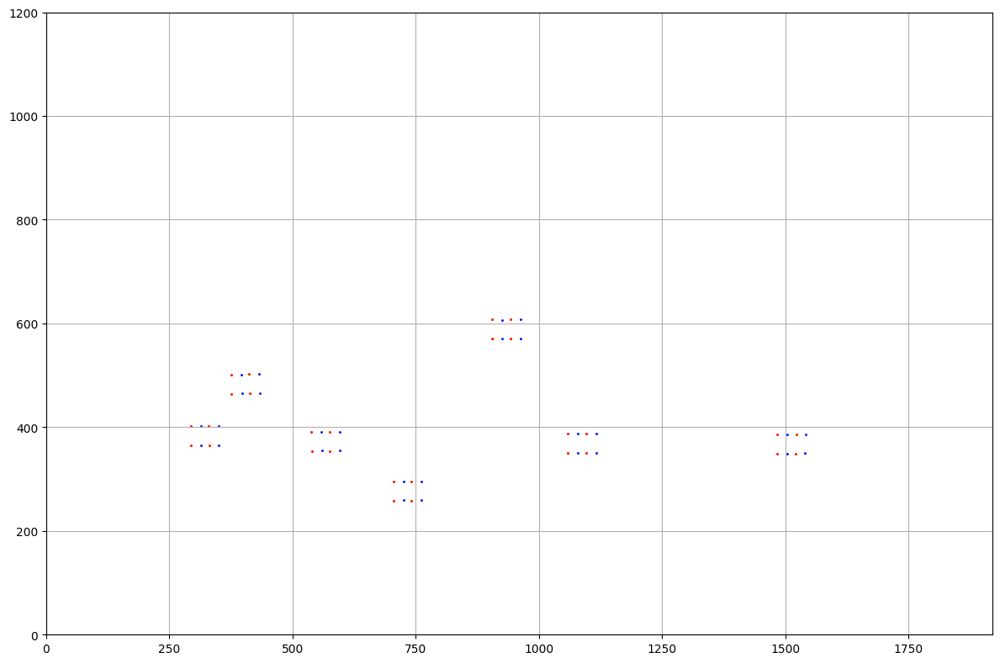

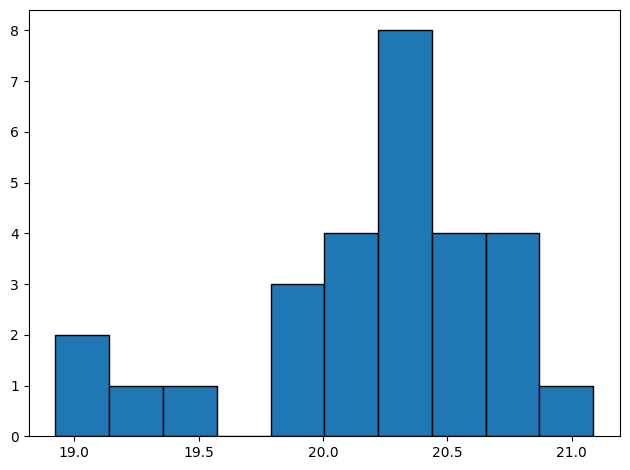

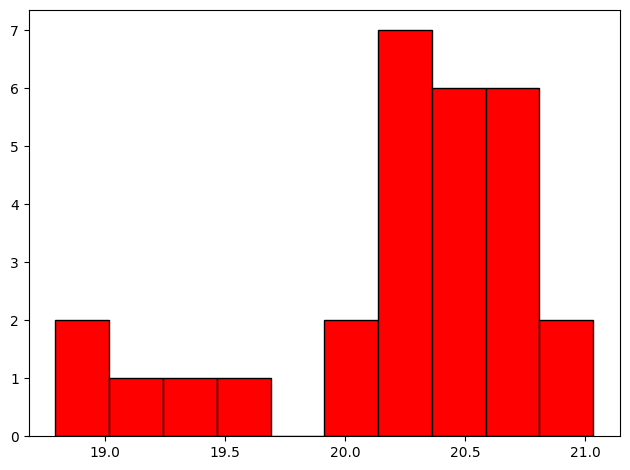

 depth at max disparity from the points projection is 324.356486165827
 depth at min disparity from the points projection is 361.4052354935386
 depth at median disparity from the points projection is 336.3341013315012
Accuracy at max disparity value of 21.0863037109375 is  Value -> 7.326718238335145%
Accuracy at Min disparity value of 18.9246826171875 is  Value -> -3.2586387124396037%
Accuracy at median disparity value of 20.335372924804688 is  Value -> 3.9045424767139467%






 depth at max disparity from the undistorted image detection is 325.1696974806525
 depth at min disparity from the undistorted image detection is 363.89329850295695
 depth at median disparity from the undistorted image detection is 336.2278868446879
Accuracy at max disparity value of 21.0335693359375 is  Value -> 7.094372148385007%
Accuracy at Min disparity value of 18.7952880859375 is  Value -> -3.9695138579877005%
Accuracy at median disparity value of 20.341796875 is  Value -> 3.934889472946322%


Next marker

In [8]:
folder_pth = "/Users/blackbird-m1/luxonis/depthai-repos/depthai-python/utilities/cam_15_arucos"
ts = "20230613_170205"
calib_path = "./calib_15_old.json"
parse_dataset(folder_pth, calib_path, ts)